In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import shutil
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
# Output directory to clear
output_dir = "/content/combined_files"

# Clear the contents of the output directory
shutil.rmtree(output_dir, ignore_errors=True)
os.makedirs(output_dir, exist_ok=True)

print(f"Contents of {output_dir} cleared.")

Contents of /content/combined_files cleared.


In [ ]:
import librosa
import soundfile as sf

# Path to the dataset
dataset_path = "/content/drive/MyDrive/Speech_audios_dataset/1500_pcm_speeches"

# Output directory to save the combined files
output_dir = "/content/combined_files"

# Create the output directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

# List of speaker folders
speaker_folders = [
    "Malak_Waleed",
    "Muhammed_Ahmed",
    "Youssef_Salama",
    "Sara_Alaa",
    "Hoor_Ayman"
]

# Number of files to combine for each speaker
num_files_to_combine = 120

# Iterate over each speaker's folder
for speaker_folder in speaker_folders:
    speaker_folder_path = os.path.join(dataset_path, speaker_folder)

    # List the first num_files_to_combine WAV files in the speaker's folder
    wav_files = [f"segment_{i}.wav" for i in range(1, num_files_to_combine + 1)]

    # Combine all WAV files into a single long file
    combined_audio = []
    for wav_file in wav_files:
        wav_file_path = os.path.join(speaker_folder_path, wav_file)
        audio, sr = librosa.load(wav_file_path, sr=None)
        combined_audio.extend(audio)

    # Save the combined audio file
    output_file_path = os.path.join(output_dir, f"{speaker_folder}_combined.wav")
    sf.write(output_file_path, combined_audio, sr)

print("Combination complete. Combined files saved in:", output_dir)

Combination complete. Combined files saved in: /content/combined_files


In [ ]:
from IPython.display import display, Audio

# Function to play audio file
def play_audio(audio_path):
    display(Audio(filename=audio_path))

# Play a specific combined audio file
speaker_folder = "Malak_Waleed_combined"
audio_path = os.path.join(output_dir, f"{speaker_folder}.wav")
print(f"Click the play button to listen: {audio_path}")
play_audio(audio_path)


Click the play button to listen: /content/combined_files/Malak_Waleed_combined.wav


In [ ]:
# Play a specific combined audio file
speaker_folder = "Muhammed_Ahmed_combined"
audio_path = os.path.join(output_dir, f"{speaker_folder}.wav")
print(f"Click the play button to listen: {audio_path}")
play_audio(audio_path)

Click the play button to listen: /content/combined_files/Muhammed_Ahmed_combined.wav


<ipython-input-8-8154279209ac>:19: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


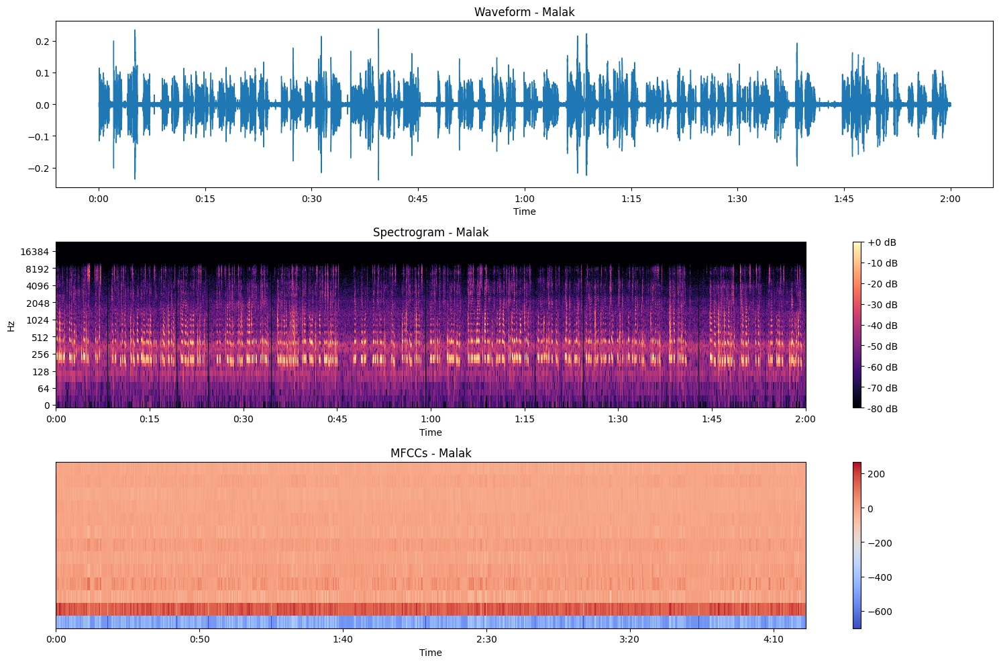

<ipython-input-8-8154279209ac>:19: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


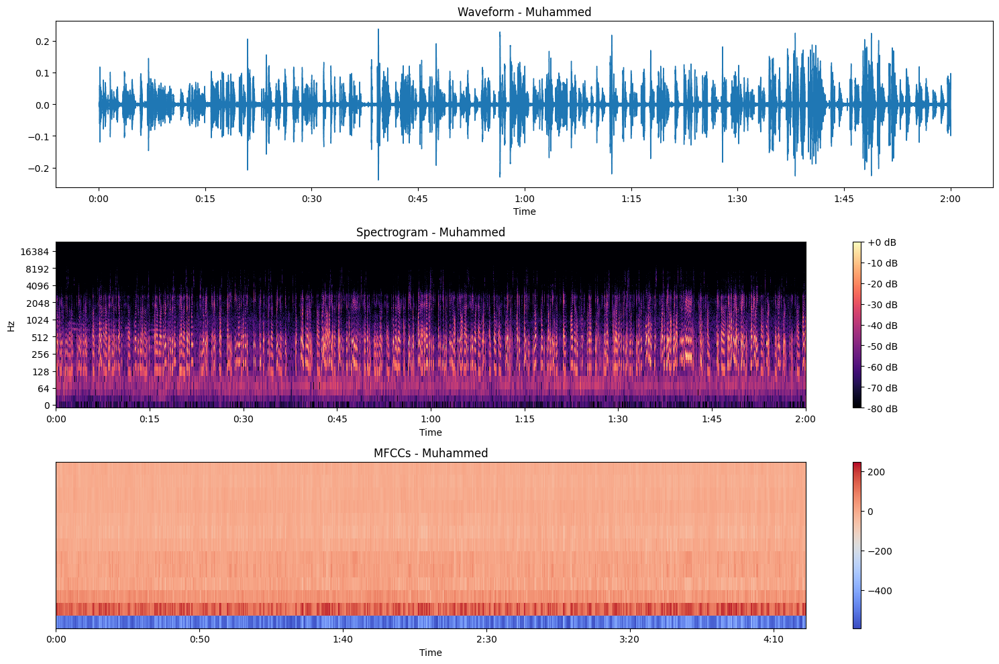

In [ ]:
import librosa.display

# Function to plot the waveform, spectrogram, and MFCCs
def plot_audio_features(audio_path):
    # Load audio file
    y, sr = librosa.load(audio_path, sr=None)

    # Extract speaker name from the file path
    speaker_name = os.path.basename(audio_path).split('_')[0]

    # Plot the waveform
    plt.figure(figsize=(15, 10))
    plt.subplot(3, 1, 1)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f'Waveform - {speaker_name}')

    # Plot the spectrogram
    plt.subplot(3, 1, 2)
    D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Spectrogram - {speaker_name}')

    # Plot the MFCCs
    plt.subplot(3, 1, 3)
    mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
    librosa.display.specshow(mfccs, x_axis='time')
    plt.colorbar()
    plt.title(f'MFCCs - {speaker_name}')

    plt.tight_layout()
    plt.show()

# Paths to the combined audio files
audio_paths = [
    '/content/combined_files/Malak_Waleed_combined.wav',
    '/content/combined_files/Muhammed_Ahmed_combined.wav'
]

# Plot features for each audio file
for audio_path in audio_paths:
    plot_audio_features(audio_path)


In [ ]:
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from sklearn.model_selection import train_test_split
import os
import numpy as np
import librosa
from tensorflow.keras.preprocessing.sequence import pad_sequences

# Set the parent directory for speaker folders
parent_dir = "/content/drive/MyDrive/Speech_audios_dataset/1500_pcm_speeches"

# List of speaker folders
speaker_folders = [
   "Malak_Waleed",
    "Muhammed_Ahmed",
    "Youssef_Salama",
    "Sara_Alaa",
    "Hoor_Ayman"
]



# Rest of your code...

# Function definition to extract features

from tensorflow.keras.preprocessing.sequence import pad_sequences
def extract_features(parent_dir, speaker_folders, max_len=None):
    features = []
    labels = []

    for i, speaker_folder in enumerate(speaker_folders):
        speaker_folder_path = os.path.join(parent_dir, speaker_folder)

        for filename in os.listdir(speaker_folder_path):
            if filename.endswith(".wav"):
                file_path = os.path.join(speaker_folder_path, filename)
                audio, sr = librosa.load(file_path, sr=None, duration=1)  # Read only 1 second
                mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=12)

                # Pad sequences to max_len
                mfccs = pad_sequences([mfccs.T], maxlen=max_len, padding='post')[0]
                mfccs = StandardScaler().fit_transform(mfccs)

                features.append(mfccs)
                labels.append(i)

    return np.array(features), np.array(labels)

# Extract features and labels
max_len = 100  # You can set the maximum length as per your requirement
X, y = extract_features(parent_dir, speaker_folders, max_len=max_len)

In [ ]:
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from sklearn.model_selection import train_test_split
import os
import numpy as np
import librosa
from tensorflow.keras.preprocessing.sequence import pad_sequences

# Set the parent directory for speaker folders
parent_dir = "/content/drive/MyDrive/Speech_audios_dataset/1500_pcm_speeches"

# List of speaker folders
speaker_folders = [
   "Malak_Waleed",
    "Muhammed_Ahmed",
    "Youssef_Salama",
    "Sara_Alaa",
    "Hoor_Ayman"
]



# Rest of your code...

# Function definition to extract features

from tensorflow.keras.preprocessing.sequence import pad_sequences
def extract_features(parent_dir, speaker_folders, max_len=None):
    features = []
    labels = []

    for i, speaker_folder in enumerate(speaker_folders):
        speaker_folder_path = os.path.join(parent_dir, speaker_folder)

        for filename in os.listdir(speaker_folder_path):
            if filename.endswith(".wav"):
                file_path = os.path.join(speaker_folder_path, filename)
                audio, sr = librosa.load(file_path, sr=None, duration=1)  # Read only 1 second
                mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=13)

                # Pad sequences to max_len
                print("------------------------------")
                print(len(mfccs.T))
                if len(mfccs.T) < max_len:
                    mfccs = pad_sequences([mfccs.T], maxlen=max_len, padding='post')[0]
                    mfccs = StandardScaler().fit_transform(mfccs)
                print(len(mfccs))
                print("------------------------------")
                features.append(mfccs)
                labels.append(i)

    return np.array(features), np.array(labels)

# Extract features and labels
max_len = 100  # You can set the maximum length as per your requirement
X, y = extract_features(parent_dir, speaker_folders, max_len=max_len)

Streaming output truncated to the last 5000 lines.
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
------------------------------
------------------------------
94
100
--------------

In [ ]:
    print(len(X))
    print(len(X[1]))
    print(len(X[1][0]))

3232
100
13


In [ ]:
x = -3
print(len(X))
print(len(X[x]))
print(len(X[x][5]))

3232
100
13


In [ ]:
np.array(X)

array([[[-6.84160882e-01, -1.39460068e-01,  1.17263124e+00, ...,
          2.05253009e-01, -1.56053874e-01,  1.11294267e+00],
        [-5.25146150e-01,  4.04884068e-02,  5.42184339e-01, ...,
          6.02516896e-01,  2.47533732e-01,  1.11294267e+00],
        [-5.80801306e-01, -1.39460068e-01,  3.32035370e-01, ...,
          8.67359488e-01,  3.82062934e-01,  8.75134403e-01],
        ...,
        [ 3.73644865e+00, -3.35603905e+00,  4.72134683e-01, ...,
          1.92672985e+00,  6.51121338e-01,  1.46965506e+00],
        [ 3.73644865e+00, -3.35603905e+00,  4.72134683e-01, ...,
          1.92672985e+00,  6.51121338e-01,  1.46965506e+00],
        [ 3.73644865e+00, -3.35603905e+00,  4.72134683e-01, ...,
          1.92672985e+00,  6.51121338e-01,  1.46965506e+00]],

       [[ 8.34264406e-01, -6.84841575e-01,  2.03684893e+00, ...,
          1.15997105e+00, -5.07057692e-01,  8.77454036e-01],
        [ 3.85993376e-01, -4.96231943e-01,  2.03684893e+00, ...,
          8.11979733e-01, -6.22036760e

In [ ]:
# Print the first few features
import time
for feature in X:
    print(len(feature))
    time.sleep(0.1)

100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100


In [ ]:
print(tf.config.list_physical_devices('GPU'))

[]


In [ ]:
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import LabelEncoder

# Encode labels with explicit classes
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)
label_encoder.classes_ = np.array(speaker_folders)

# Split the data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Print the shapes of training and validation data
print("Training Data Shape:", X_train.shape)
print("Validation Data Shape:", X_val.shape)

Training Data Shape: (2262, 100, 13)
Validation Data Shape: (485, 100, 13)


In [ ]:
# Define the RNN model
model = tf.keras.Sequential([
    tf.keras.layers.LSTM(128, input_shape=(X_train.shape[1], X_train.shape[2])),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(len(speaker_folders), activation='softmax')
])

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=2, restore_best_weights=True)

# Train the model with EarlyStopping
history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=20, batch_size=32, callbacks=[early_stopping])

# Check if EarlyStopping triggered
if early_stopping.stopped_epoch > 0:
    print("Early stopping triggered at epoch", early_stopping.stopped_epoch + 1)
else:
    print("Training completed without early stopping")

Epoch 1/20
71/71 [==============================] - 12s 122ms/step - loss: 0.6204 - accuracy: 0.8050 - val_loss: 0.2698 - val_accuracy: 0.8948
Epoch 2/20
71/71 [==============================] - 10s 139ms/step - loss: 0.1571 - accuracy: 0.9452 - val_loss: 0.1807 - val_accuracy: 0.9320
Epoch 3/20
71/71 [==============================] - 8s 106ms/step - loss: 0.1000 - accuracy: 0.9660 - val_loss: 0.1579 - val_accuracy: 0.9402
Epoch 4/20
71/71 [==============================] - 10s 138ms/step - loss: 0.0692 - accuracy: 0.9775 - val_loss: 0.1711 - val_accuracy: 0.9423
Epoch 5/20
71/71 [==============================] - 10s 139ms/step - loss: 0.0695 - accuracy: 0.9757 - val_loss: 0.1502 - val_accuracy: 0.9485
Epoch 6/20
71/71 [==============================] - 8s 107ms/step - loss: 0.0354 - accuracy: 0.9872 - val_loss: 0.1089 - val_accuracy: 0.9629
Epoch 7/20
71/71 [==============================] - 10s 141ms/step - loss: 0.0354 - accuracy: 0.9867 - val_loss: 0.0936 - val_accuracy: 0.9711
E

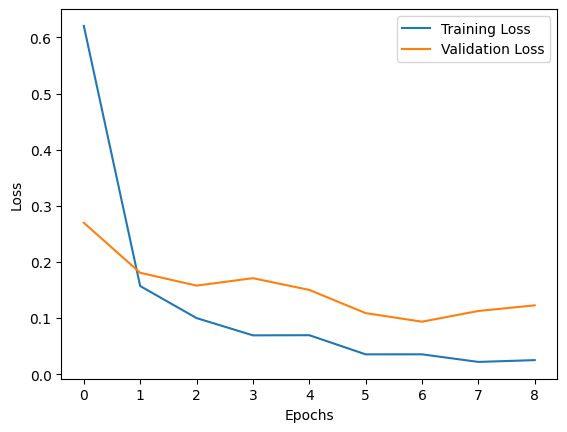

In [ ]:
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

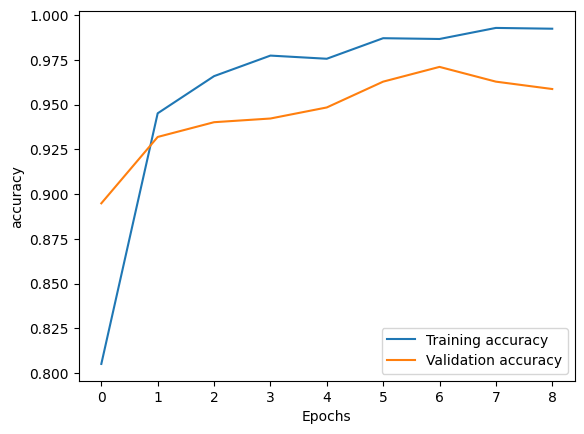

In [ ]:
plt.plot(history.history['accuracy'], label='Training accuracy')
plt.plot(history.history['val_accuracy'], label='Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('accuracy')
plt.legend()
plt.show()

16/16 [==============================] - 1s 37ms/step
Test Evaluation Accuracy: 0.9587628865979382
Weighted F1 Score: 0.9589667281040773


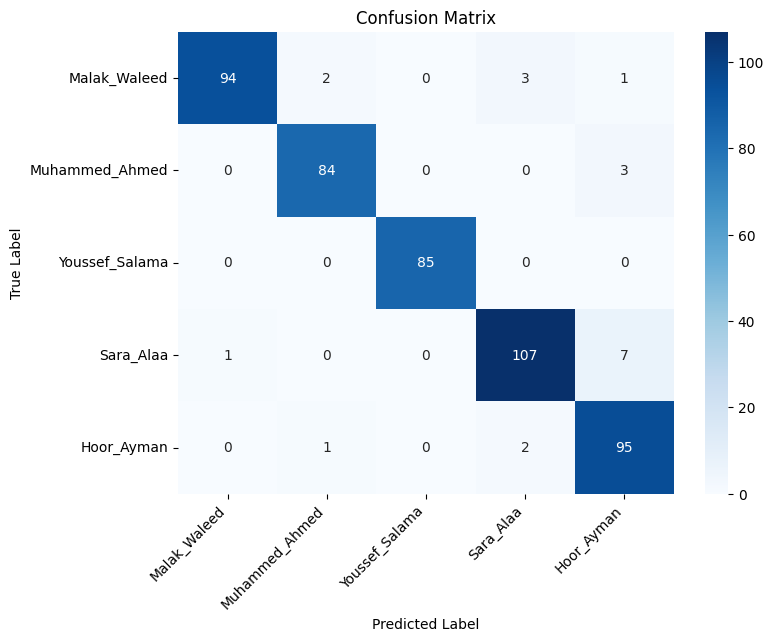

In [ ]:
import seaborn as sns
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, f1_score

# Evaluate the model on the test set
y_pred_probabilities = model.predict(X_test)
y_pred = np.argmax(y_pred_probabilities, axis=1)

# Decode labels back to original format
y_test_decoded = label_encoder.inverse_transform(y_test)
y_pred_decoded = label_encoder.inverse_transform(y_pred)

# Create a confusion matrix
conf_matrix = confusion_matrix(y_test_decoded, y_pred_decoded, labels=speaker_folders)

# Calculate accuracy
accuracy = accuracy_score(y_test_decoded, y_pred_decoded)
print(f"Test Evaluation Accuracy: {accuracy}")

# Calculate F1 score
f1 = f1_score(y_test_decoded, y_pred_decoded, labels=speaker_folders, average='weighted')
print(f"Weighted F1 Score: {f1}")

# Plot the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=speaker_folders, yticklabels=speaker_folders)

# Rotate x-axis labels by 45 degrees
plt.xticks(rotation=45, ha="right")

plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

In [ ]:
def predict_speaker(audio_path):
    # Extract features from the audio file
    audio, sr = librosa.load(audio_path, sr=None, duration=1)
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=13)
    mfccs = pad_sequences([mfccs.T], maxlen=max_len, padding='post')[0]
    mfccs = StandardScaler().fit_transform(mfccs)
    features = np.array([mfccs])

    # Make a prediction
    prediction_probabilities = model.predict(features)
    predicted_label_index = np.argmax(prediction_probabilities)
    predicted_speaker = label_encoder.classes_[predicted_label_index]

    return predicted_speaker

# Example usage:

audio_path = "/content/Malak.wav"
predicted_speaker = predict_speaker(audio_path)
print("Predicted Speaker:", predicted_speaker)

audio_path = "/content/Muhammed.wav"
predicted_speaker = predict_speaker(audio_path)
print("Predicted Speaker:", predicted_speaker)


